In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
# ! pip uninstall numba -y && pip install numba

In [3]:
import os
import sys

# Получаем абсолютный путь к корневой директории проекта (директория выше текущей)
root_path = os.path.abspath(os.path.join(os.getcwd(), '..'))

# Добавляем корневую директорию в sys.path
if root_path not in sys.path:
    sys.path.append(root_path)

In [13]:
from model_loaders import load_ss_model
import weightwatcher as ww
from matplotlib import pyplot as plt
from pipeline import separate_audio
import torch
from utils import parse_yaml
from models.clap_encoder import CLAP_Encoder
import IPython.display as ipd
from models.audiosep_lora import AudioSepLora

In [5]:
SS_CONFIG_PATH = '../config/audiosep_base.yaml'
CLAP_CKPT_PATH = '../checkpoint/music_speech_audioset_epoch_15_esc_89.98.pt'
AUDIOSEP_CKPT_PATH = '../checkpoint/audiosep_base_4M_steps.ckpt'

In [6]:
def describe_weights(model):
    watcher = ww.WeightWatcher()
    details = watcher.analyze(model=model)
    summary = watcher.get_summary(details)

    return details, summary

def plot_hist(details):
    avg_alpha = details.alpha.mean()

    title=f"WeightWatcher Alpha"
    details.alpha.plot.hist(bins=100)
    plt.title(title)
    plt.axvline(x=avg_alpha, color='green',label=f"<alpha> = {avg_alpha:0.3f}")
    plt.legend()

In [7]:
device = torch.device('cuda')
configs = parse_yaml(SS_CONFIG_PATH)

query_encoder = CLAP_Encoder(pretrained_path = CLAP_CKPT_PATH).eval().to(device)
base_model = load_ss_model(configs=configs, checkpoint_path=AUDIOSEP_CKPT_PATH, query_encoder=query_encoder).eval().to(device)

2024-03-08 21:50:36,268 - INFO - Loading HTSAT-base model config.
2024-03-08 21:50:40,210 - INFO - Loading pretrained HTSAT-base-roberta weights (../checkpoint/music_speech_audioset_epoch_15_esc_89.98.pt).


In [53]:
audio_file = '../audios/test.wav'
text = 'singing'
output_file = '../separation_result/test.wav'

# AudioSep processes the audio at 32 kHz sampling rate
separate_audio(base_model, audio_file, text, output_file, device, use_chunk=True)

Separating audio from [../audios/test.wav] with textual query: [singing]
Separated audio written to [../separation_result/test.wav]


In [54]:
ipd.Audio('../separation_result/test.wav') # load a local WAV file

In [55]:
query_encoder_for_lora = CLAP_Encoder(pretrained_path = CLAP_CKPT_PATH).eval().to(device)
base_model_for_lora = load_ss_model(configs=configs, checkpoint_path=AUDIOSEP_CKPT_PATH, query_encoder=query_encoder_for_lora).eval().to(device)

lora_model = AudioSepLora.load_from_checkpoint(
    checkpoint_path='../checkpoints/train_audiosep_lora/audiosep_lora_musdb18,timestamp=1709925025.5818596/epoch=69.ckpt',
    strict=False,
    pretrained_audiosep_model = base_model_for_lora,
    loss_function=None,
    waveform_mixer=None,
    lr_lambda_func=None
) \
    .eval() \
    .to(device)

merged_lora_model = lora_model.model.merge_and_unload()

2024-03-08 23:24:27,992 - INFO - Loading HTSAT-base model config.
2024-03-08 23:24:29,300 - INFO - Loading pretrained HTSAT-base-roberta weights (../checkpoint/music_speech_audioset_epoch_15_esc_89.98.pt).


In [56]:
output_file2 = '../separation_result/test2.wav'

# AudioSep processes the audio at 32 kHz sampling rate
separate_audio(merged_lora_model, audio_file, text, output_file2, device, use_chunk=True)

Separating audio from [../audios/test.wav] with textual query: [singing]
Separated audio written to [../separation_result/test2.wav]


In [57]:
ipd.Audio('../separation_result/test2.wav') # load a local WAV file

In [22]:
plt.rcParams["figure.figsize"] = (20,3)

{'log_norm': 3.4622441728944704, 'alpha': 3.4710740844774923, 'alpha_weighted': 6.590802155253461, 'log_alpha_norm': 7.088332035155279, 'log_spectral_norm': 2.1900739450051367, 'stable_rank': 39.89981500874082}


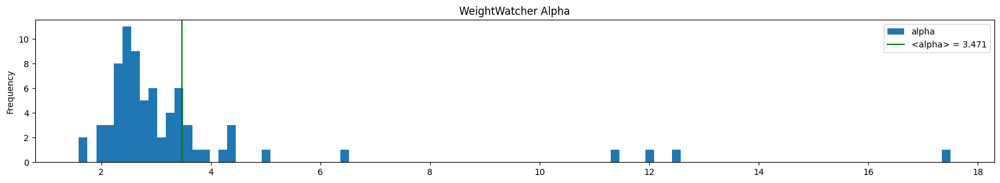

In [58]:
details, summary = describe_weights(base_model.ss_model)
plot_hist(details)
print(summary)

In [73]:
watcher = ww.WeightWatcher()
avg_dW, avg_db, distances = watcher.distances(base_model.ss_model, merged_lora_model.ss_model)
avg_dW, avg_db

(3.295, 0.0)

In [74]:
distances

,method,name,delta_W,delta_b,M,N,b_shape,longname
layer_id,,,,,,,,
14,raw,Conv2d,0.703613,0.0,3,32,unknown,base.encoder_block1.conv_block1.conv1
15,raw,Conv2d,0.447510,0.0,3,32,unknown,base.encoder_block1.conv_block1.conv2
20,raw,Conv2d,1.162109,0.0,3,64,unknown,base.encoder_block2.conv_block1.conv1
21,raw,Conv2d,1.203125,0.0,3,64,unknown,base.encoder_block2.conv_block1.conv2
22,raw,Conv2d,0.449951,0.0,1,64,unknown,base.encoder_block2.conv_block1.shortcut
...,...,...,...,...,...,...,...,...
151,raw,Linear,0.000000,0.0,64,512,64,film.decoder_block5->conv_block2->beta2
152,raw,Linear,0.000000,0.0,64,512,64,film.decoder_block6->beta1
153,raw,Linear,0.000000,0.0,64,512,64,film.decoder_block6->beta2
